# Using Principal Component Analysis (PCA) and Robust Principal Component Analysis (RPCA) for Singing Voice Separation

Jaemin Cheun (jcheun@college.harvard.edu) and Rachel Moon (rachelmoon@g.harvard.edu)

### Introduction

In this jupyter notebook, we will be demonstrating two techniques that can be used to separate the singer's voice from instrumental background music: PCA (Principal Component Analysis) and RPCA (Robust Principal Component Analysis). We will be testing both techinques on the MIR-1K dataset, which can be accessed [here](http://mirlab.org/dataset/public/).

### Import necessary packages

In [1]:
# import packages
import librosa
from librosa.display import specshow, waveplot
import numpy as np
from scipy import signal
from scipy.io import wavfile
import matplotlib.pyplot as plt
import glob
import os
import IPython.display as ipd
from sklearn.decomposition import PCA
%matplotlib inline

In [2]:
# set window size and hop size
len_window = 1024
len_hop = 256

### Explore Example: "Yesterday" by the Beatles

In this section, we will be attempting singing voice seperation on a popular song named "Yesterday" by the Beatles.

We will first import the song:

In [7]:
file_name = "input/beatles-yesterday.wav"
sound, sample_rate = librosa.load(file_name, mono=False, duration=25)
sound = librosa.to_mono(sound)
ipd.Audio(sound, rate = sample_rate)

We will apply discrete-time Short-Time Fourier Transform (STFT):

In [8]:
spectrogram = librosa.stft(sound, n_fft=len_window, hop_length=len_hop).astype(np.float32)

/Users/jaemincheun/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: ComplexWarning: Casting complex values to real discards the imaginary part
  """Entry point for launching an IPython kernel.


We can visualize the spectrogram of the original music:

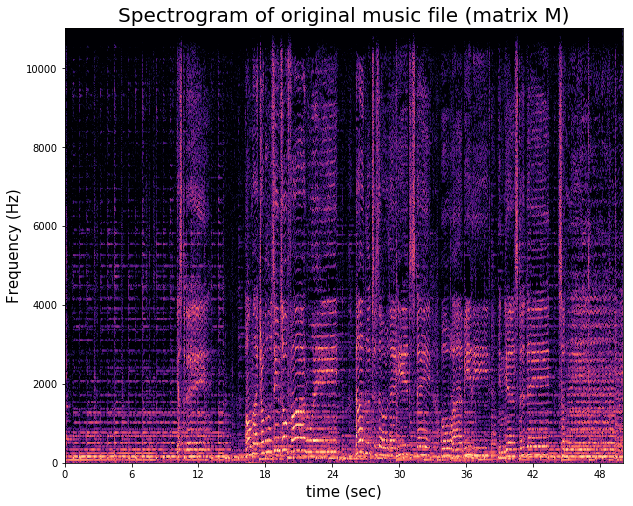

In [34]:
D = librosa.amplitude_to_db(np.abs(spectrogram), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of original music file (matrix M)", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

### Using PCA for Singing Voice Seperation

We will first use PCA as Noise Filtering in order to separate the voice from the background music. The idea is that any components with variance greater than the effect of the noise should relatively unaffected by the noise. Therefore, if we reconstruct the data with the largest subset of the principle components, we will hopefully remove the noise (voice) while keeping the signal (background music).

In [10]:
variance = 0.5
pca = PCA(variance).fit(spectrogram)
pca.n_components_

5

We see that 50% of the variance amounts to 6 principal components. We then compute these principal components and take the inverse to recontruct the signal:

In [37]:
components = pca.transform(spectrogram)
filtered = pca.inverse_transform(components)
noise = spectrogram - filtered

We can visualize the spectrogram of the signal after PCA:

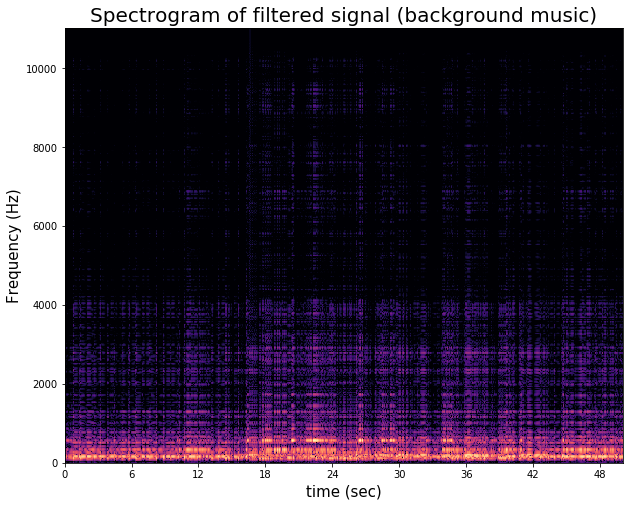

In [38]:
D = librosa.amplitude_to_db(np.abs(filtered), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of filtered signal (background music)", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

We can also listen to the recovered signal, which in this case is the background music.

In [39]:
output_filtered = librosa.istft(filtered)
ipd.Audio(output_filtered, rate = sample_rate)

Let's do the same thing for the noise:

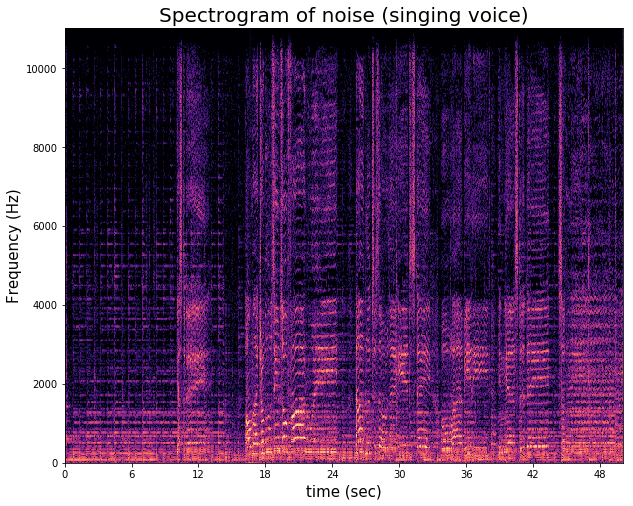

In [40]:
D = librosa.amplitude_to_db(np.abs(noise), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of noise (singing voice)", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

In [41]:
output_noise = librosa.istft(noise)
ipd.Audio(output_noise, rate = sample_rate)

### Binary Time-Frequency Masking

We can also apply binary frequency mask to improve the separation results.

In [49]:
# binary time-frequency masking
# set gain = 1 as in the paper
gain = 1
M_b = 1 * (np.abs(noise) > gain * np.abs(filtered))

pca_singing = np.multiply(M_b, spectrogram)
pca_music = np.multiply((1 - M_b), spectrogram)

Below is the singing voice from PCA using Binary Time-Frequency Masking:

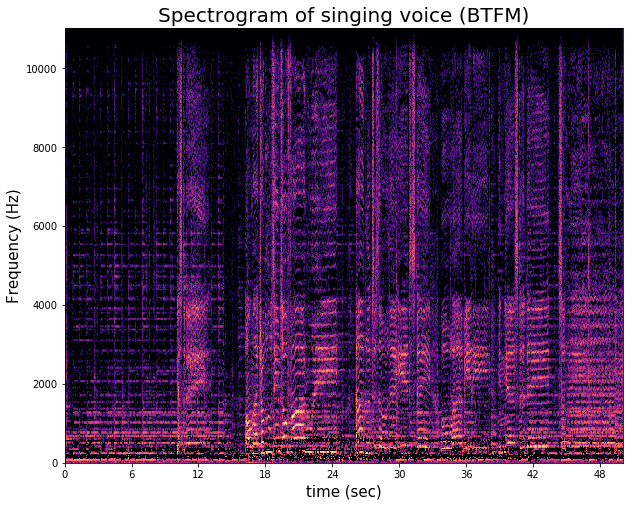

In [53]:
D = librosa.amplitude_to_db(np.abs(pca_singing), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of singing voice (BTFM)", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

In [54]:
output_pca_singing = librosa.istft(pca_singing)
ipd.Audio(output_pca_singing, rate = sample_rate)

We see that the PCA does not do a good job of separating the voice from the background music. This is because PCA is not capturing the difference between the voice and the instrumental.

### Using RPCA for Singing Voice Seperation

We will now use RPCA as Noise Filtering in order to separate the voice from the background music. The assumption is that the background music in a song exhibits a low-rank signal, because background miusic tends to have a reptitive musical structure with musical instruments that emit the same sounds when played. On the other hand,  the singing voice can be represented as a high-rank sparse matrix, because the singing voice has more variation than musical instruments. 

Robust principal component analysis (RPCA) is a matrix factorization algorithm that can separate low-rank and sparse matrices, which can be used to separate sparse song voice matrix from low-rank instrumental background matrix.

We first define the RPCA algorithm:

In [105]:
# Adapted from https://github.com/dganguli/robust-pca/blob/master/r_pca.py
class RPCA_ALM:
    def __init__(self, D, mu = None):
        self.D = D
        self.E0 = np.zeros(self.D.shape)
        self.mu = np.prod(self.D.shape) / (4 * self.norm_p(self.D, 2))
        self.mu_inv = 1 / self.mu
        self.lmbda = 1 / np.sqrt(np.max(self.D.shape))
        self.Y0 = D / self.J(D, self.lmbda)

    @staticmethod
    def J(M, lam):
        return max(np.linalg.norm(M), 
                   1/lam * max(M.min(), M.max(), key=abs))
    @staticmethod
    def norm_p(M, p):
        return np.sum(np.power(M, p))

    @staticmethod
    def shrink(M, tau):
        return np.sign(M) * np.maximum((np.abs(M) - tau), np.zeros(M.shape))

    def fit(self, max_iter=1000):
        j = 0
        error = float("inf")
    
        Ak = np.zeros(self.D.shape)
        Ek = self.E0
        Yk = self.Y0
        
        tol = 1E-7 * self.norm_p(np.abs(self.D), 2)

        while (error > tol) and j < max_iter:
            U, S, V = np.linalg.svd(self.D - Ek + self.mu_inv * Yk, full_matrices=False)
            Ak = np.dot(U, np.dot(np.diag(self.shrink(S, self.mu_inv)), V))

            Ek = self.shrink(
                self.D - Ak + (self.mu_inv * Yk), self.mu_inv * self.lmbda)
            Yk = Yk + self.mu * (self.D - Ak - Ek)
            error = self.norm_p(np.abs(self.D - Ak - Ek), 2)
            j += 1
        return Ak, Ek

We then fit RPCA to the music. Note that L is the background music and S is the voice:

In [106]:
# rPCA
RPCA = RPCA_ALM(spectrogram)
L, S = RPCA.fit(max_iter=10000)

We can visualize the spectrogram of the voice after RPCA:

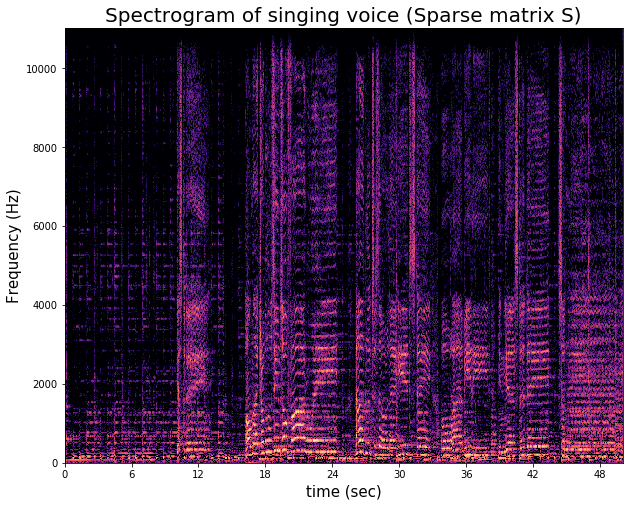

In [107]:
D = librosa.amplitude_to_db(np.abs(S), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of singing voice (Sparse matrix S)", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

We can also listen to the voice:

In [108]:
output_S = librosa.istft(S)
ipd.Audio(output_S, rate = sample_rate)

Let's do the same thing for the background music:

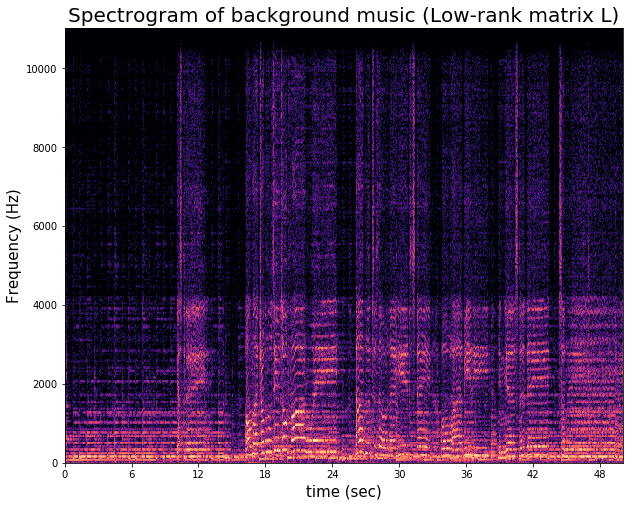

In [100]:
D = librosa.amplitude_to_db(np.abs(L), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of background music (Low-rank matrix L)", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

In [101]:
output_L = librosa.istft(L)
ipd.Audio(output_L, rate = sample_rate)

### Binary Time-Frequency Masking

We can also apply binary frequency mask to improve the separation results.

In [109]:
# binary time-frequency masking
# set gain = 1 as in the paper
gain = 1
M_b = 1 * (np.abs(S) > gain * np.abs(L))

rpca_singing = np.multiply(M_b, spectrogram)

Below is the singing voice from RPCA using Binary Time-Frequency Masking:

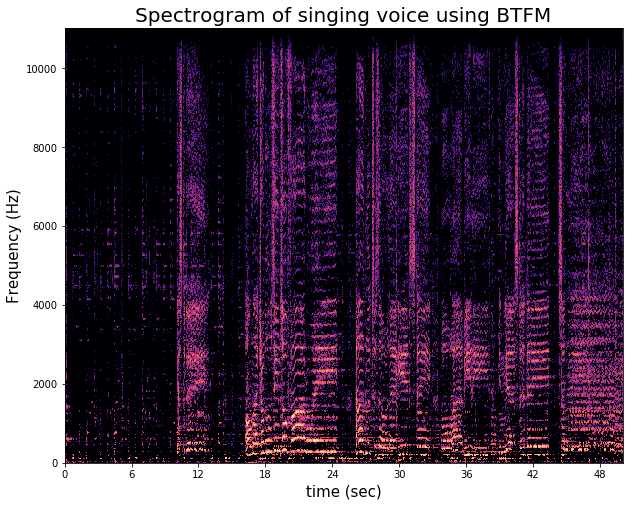

In [110]:
D = librosa.amplitude_to_db(np.abs(rpca_singing), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of singing voice using BTFM", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

In [104]:
output_rpca_singing = librosa.istft(rpca_singing)
ipd.Audio(output_rpca_singing, rate = sample_rate)

We see that the RPCA does a descent job at separating the voice from the music. Moreover, the Binary Time Frequency Masking seems to help lower the volume of the background music, but it also damages the quality of the voice.

# Using RPCA and PCA and MIR-1K

In [ ]:
original_files = glob.glob('MIR-1K/Wavfile/*.wav')

NSDR_RPCA_dict = {}
NSDR_RPCA_mask_dict = {}
NSDR_PCA_dict = {}
NSDR_PCA_mask_dict = {}
song_duration_dict = {}
for f in original_files[:100]:
    song_name = f[15:-4]
    output_folder = f"output/{song_name}"
    try:  
        os.mkdir(output_folder)
    except OSError:  
        print ("Creation of the directory %s failed" % output_folder)
    sound, sample_rate = librosa.load(f, mono=False)
    real_mr, real_voice = sound[0], sound[1]
    
    # Note song duration
    song_duration_dict[song_name] = librosa.get_duration(y=sound, sr=sample_rate)
    
    # Output real mr and real voice
    librosa.output.write_wav(path = f'{output_folder}/real_mr.wav', y = real_mr, sr = sample_rate, norm = False)
    librosa.output.write_wav(path = f'{output_folder}/real_voice.wav', y = real_voice, sr = sample_rate, norm = False)
    
    # convert stereo music to monaural file
    mono = librosa.to_mono(sound)
    
    # stft conversion
    spectrogram_mono = librosa.stft(mono, n_fft=len_window, hop_length=len_hop).astype(np.float32)
    spectrogram_voice = librosa.stft(real_voice, n_fft=len_window, hop_length=len_hop).astype(np.float32)
    
    # PCA
    pca = PCA(0.5).fit(spectrogram_mono)
    components = pca.transform(spectrogram_mono)
    filtered = pca.inverse_transform(components)
    noise = spectrogram_mono - filtered
    
    gain = 1
    M_b = 1 * (np.abs(noise) > gain * np.abs(filtered))
    pca_voice_mask = np.multiply(M_b, spectrogram_mono)
    
    # rPCA
    RPCA = RPCA_ALM(spectrogram_mono)
    L, S = RPCA.fit(max_iter=10000)
    
    gain = 1
    M_b = 1 * (np.abs(S) > gain * np.abs(L))
    rpca_voice_mask = np.multiply(M_b, spectrogram_mono)
    
    # Inverse stft
    output_filtered = librosa.istft(filtered)
    output_noise = librosa.istft(noise)
    output_pca_voice_mask = librosa.istft(pca_voice_mask)
    output_L = librosa.istft(L)
    output_S = librosa.istft(S)
    output_rpca_voice_mask = librosa.istft(rpca_voice_mask)
    output_voice = librosa.istft(spectrogram_voice)
    output_mono = librosa.istft(spectrogram_mono)
    
    # Output files
    librosa.output.write_wav(path = f'{output_folder}/pca_mr.wav', y = output_filtered, sr = sample_rate, norm = False)
    librosa.output.write_wav(path = f'{output_folder}/pca_voice.wav', y = output_noise, sr = sample_rate, norm = False)
    librosa.output.write_wav(path = f'{output_folder}/pca_voice_mask.wav', y = output_pca_voice_mask, sr = sample_rate, norm = False)
    librosa.output.write_wav(path = f'{output_folder}/rpca_mr.wav', y = output_L, sr = sample_rate, norm = False)
    librosa.output.write_wav(path = f'{output_folder}/rpca_voice.wav', y = output_S, sr = sample_rate, norm = False)
    librosa.output.write_wav(path = f'{output_folder}/rpca_voice_mask.wav', y = output_rpca_voice_mask, sr = sample_rate, norm = False)
    
    # Calculate NSDR
    def calc_SDR(original, resynthesized):
        inner_prod = np.inner(original, resynthesized)
        original_energy = np.linalg.norm(original)
        resynthesized_energy = np.linalg.norm(resynthesized)
        return 10 * np.log10(inner_prod ** 2 / (original_energy ** 2 * resynthesized_energy ** 2 - inner_prod ** 2))
    
    NSDR_PCA = calc_SDR(output_voice, output_noise) - calc_SDR(output_mono, output_voice)
    NSDR_PCA_mask = calc_SDR(output_voice, output_pca_voice_mask) - calc_SDR(output_mono, output_voice)
    NSDR_RPCA = calc_SDR(output_voice, output_S) - calc_SDR(output_mono, output_voice)
    NSDR_RPCA_mask = calc_SDR(output_voice, output_rpca_voice_mask) - calc_SDR(output_mono, output_voice)
    
    NSDR_PCA_dict[song_name] = NSDR_PCA
    NSDR_PCA_mask_dict[song_name] = NSDR_PCA_mask
    NSDR_RPCA_dict[song_name] = NSDR_RPCA
    NSDR_RPCA_mask_dict[song_name] = NSDR_RPCA_mask

### Best and Worst

First start with best song:

In [188]:
best_song = max(NSDR_RPCA_dict, key=NSDR_RPCA_dict.get)
best_song

'yifen_5_05'

In [190]:
NSDR_RPCA_dict[best_song]

5.133995130686643

/Users/jaemincheun/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: ComplexWarning: Casting complex values to real discards the imaginary part
  """


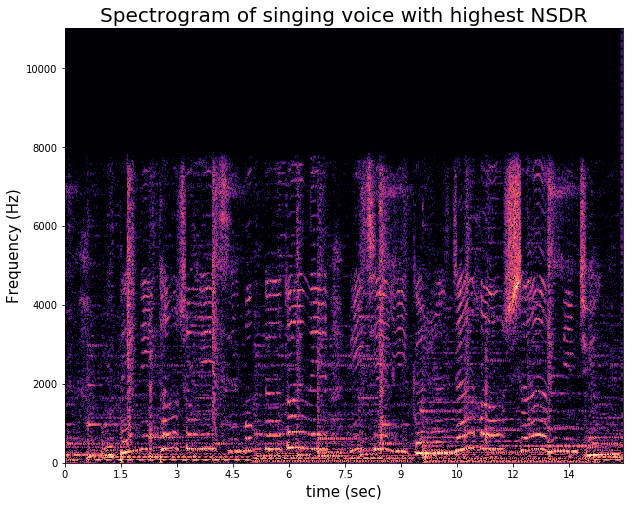

In [196]:
file_name = f"MIR-1K/Wavfile/{max(NSDR_RPCA_dict, key=NSDR_RPCA_dict.get)}.wav"
sound, sample_rate = librosa.load(file_name, mono=False, duration=25)
sound = librosa.to_mono(sound)
ipd.Audio(sound, rate = sample_rate)
spectrogram = librosa.stft(sound, n_fft=len_window, hop_length=len_hop).astype(np.float32)
# rPCA
RPCA = RPCA_ALM(spectrogram)
L, S = RPCA.fit(max_iter=10000)
D = librosa.amplitude_to_db(np.abs(S), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of singing voice with highest NSDR", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

In [174]:
output_rpca_singing = librosa.istft(rpca_singing)
ipd.Audio(output_rpca_singing, rate = sample_rate)

Worst song:

In [191]:
worst_song = min(NSDR_RPCA_dict, key=NSDR_RPCA_dict.get)
worst_song

'geniusturtle_4_09'

In [192]:
NSDR_RPCA_dict[worst_song]

-5.391159403176093

/Users/jaemincheun/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: ComplexWarning: Casting complex values to real discards the imaginary part
  """


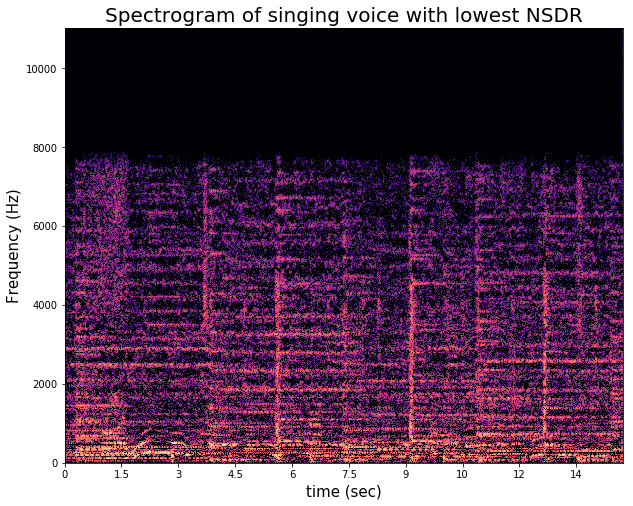

In [197]:
file_name = f"MIR-1K/Wavfile/{min(NSDR_RPCA_dict, key=NSDR_RPCA_dict.get)}.wav"
sound, sample_rate = librosa.load(file_name, mono=False, duration=25)
sound = librosa.to_mono(sound)
ipd.Audio(sound, rate = sample_rate)
spectrogram = librosa.stft(sound, n_fft=len_window, hop_length=len_hop).astype(np.float32)
# rPCA
RPCA = RPCA_ALM(spectrogram)
L, S = RPCA.fit(max_iter=10000)
D = librosa.amplitude_to_db(np.abs(S), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of singing voice with lowest NSDR", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

In [184]:
output_rpca_singing = librosa.istft(S)
ipd.Audio(output_rpca_singing, rate = sample_rate)

### Calculating GNSDR

In [159]:
def calc_GNSDR(d):
    GSNDR = 0
    total_length = 0
    for k, v in d.items():
        length = song_duration_dict[k]
        total_length += length
        GSNDR += length * v
    return GSNDR / total_length

In [163]:
GNSDR_RPCA = calc_GNSDR(NSDR_RPCA_dict)
GNSDR_RPCA_mask = calc_GNSDR(NSDR_RPCA_mask_dict)
GNSDR_PCA = calc_GNSDR(NSDR_PCA_dict)
GNSDR_PCA_mask = calc_GNSDR(NSDR_PCA_mask_dict)

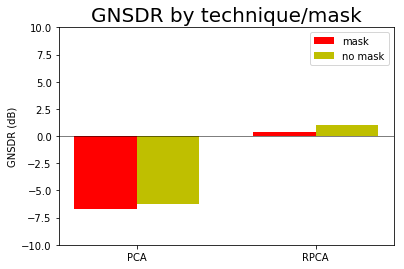

In [165]:
ind = np.arange(2)
width = 0.35
fig, ax = plt.subplots()
mask = GNSDR_PCA_mask, GNSDR_RPCA_mask
no_mask = GNSDR_PCA, GNSDR_RPCA
p1 = ax.bar(ind, mask, width, color='r')
p2 = ax.bar(ind + width, no_mask, width, color='y')
ax.set_title('GNSDR by technique/mask', fontsize=20)
ax.set_xticks(ind + width / 2)
ax.set_xticklabels(('PCA', 'RPCA'))
ax.set_ylim(-10, 10)
ax.set_ylabel("GNSDR (dB)")
ax.axhline(y=0, color="black", linewidth=0.5)
ax.legend((p1[0], p2[0]), ('mask', 'no mask'))
plt.show()

# Exploration on Different Genres

### 1. EDM

/Users/jaemincheun/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: ComplexWarning: Casting complex values to real discards the imaginary part
  """


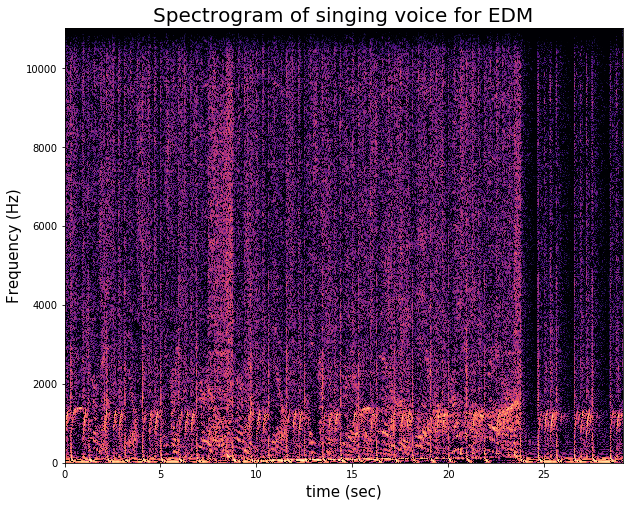

In [211]:
file_name = f"input/edm.wav"
sound, sample_rate = librosa.load(file_name, mono=False, duration=25)
sound = librosa.to_mono(sound)
ipd.Audio(sound, rate = sample_rate)
spectrogram = librosa.stft(sound, n_fft=len_window, hop_length=len_hop).astype(np.float32)
# rPCA
RPCA = RPCA_ALM(spectrogram)
L, S = RPCA.fit(max_iter=10000)
D = librosa.amplitude_to_db(np.abs(S), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of singing voice for EDM", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

In [212]:
output_rpca_singing = librosa.istft(S)
ipd.Audio(output_rpca_singing, rate = sample_rate)

### 2. Indie

/Users/jaemincheun/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: ComplexWarning: Casting complex values to real discards the imaginary part
  """


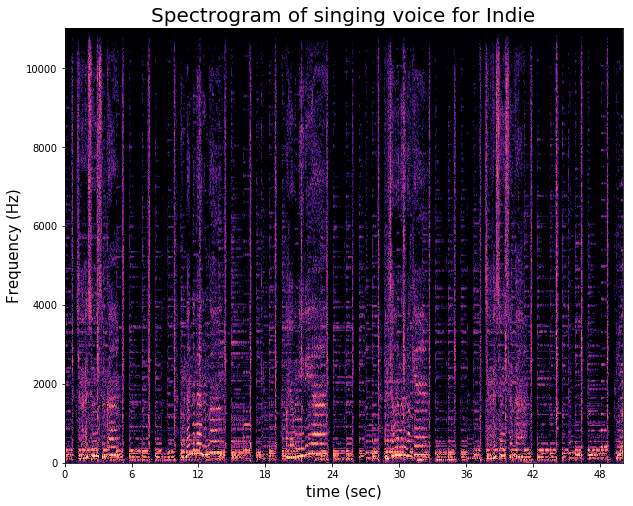

In [204]:
file_name = f"input/indie.wav"
sound, sample_rate = librosa.load(file_name, mono=False, duration=25)
sound = librosa.to_mono(sound)
ipd.Audio(sound, rate = sample_rate)
spectrogram = librosa.stft(sound, n_fft=len_window, hop_length=len_hop).astype(np.float32)
# rPCA
RPCA = RPCA_ALM(spectrogram)
L, S = RPCA.fit(max_iter=10000)
D = librosa.amplitude_to_db(np.abs(S), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of singing voice for Indie", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

In [203]:
output_rpca_singing = librosa.istft(S)
ipd.Audio(output_rpca_singing, rate = sample_rate)

### 3. Classical

/Users/jaemincheun/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: ComplexWarning: Casting complex values to real discards the imaginary part
  """


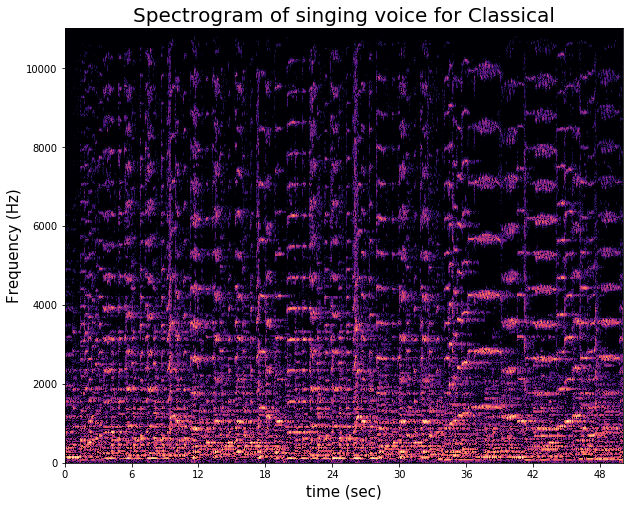

In [205]:
file_name = f"input/classical.wav"
sound, sample_rate = librosa.load(file_name, mono=False, duration=25)
sound = librosa.to_mono(sound)
ipd.Audio(sound, rate = sample_rate)
spectrogram = librosa.stft(sound, n_fft=len_window, hop_length=len_hop).astype(np.float32)
# rPCA
RPCA = RPCA_ALM(spectrogram)
L, S = RPCA.fit(max_iter=10000)
D = librosa.amplitude_to_db(np.abs(S), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of singing voice for Classical", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

In [206]:
output_rpca_singing = librosa.istft(S)
ipd.Audio(output_rpca_singing, rate = sample_rate)

### 4. Opera

/Users/jaemincheun/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: ComplexWarning: Casting complex values to real discards the imaginary part
  """


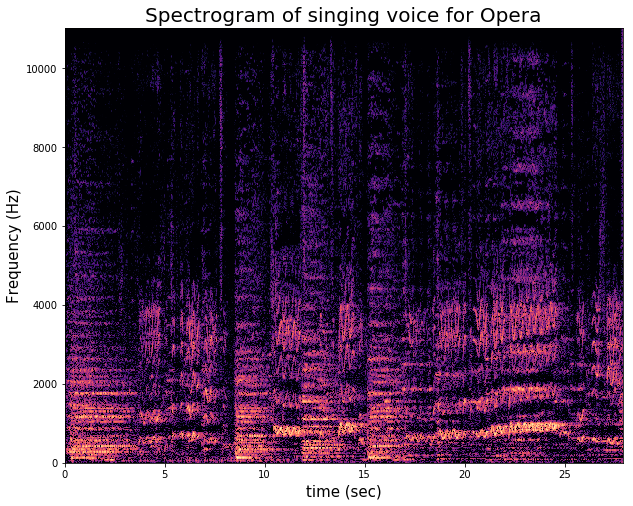

In [207]:
file_name = f"input/opera.wav"
sound, sample_rate = librosa.load(file_name, mono=False, duration=25)
sound = librosa.to_mono(sound)
ipd.Audio(sound, rate = sample_rate)
spectrogram = librosa.stft(sound, n_fft=len_window, hop_length=len_hop).astype(np.float32)
# rPCA
RPCA = RPCA_ALM(spectrogram)
L, S = RPCA.fit(max_iter=10000)
D = librosa.amplitude_to_db(np.abs(S), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of singing voice for Opera", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

In [208]:
output_rpca_singing = librosa.istft(S)
ipd.Audio(output_rpca_singing, rate = sample_rate)

### 5. Jazz

/Users/jaemincheun/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: ComplexWarning: Casting complex values to real discards the imaginary part
  """


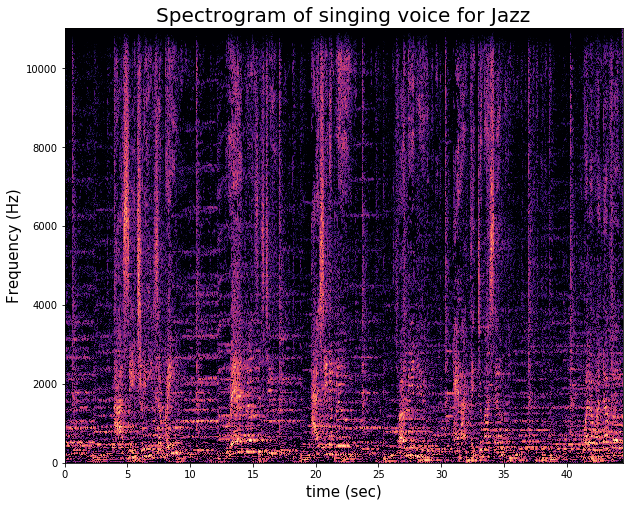

In [209]:
file_name = f"input/jazz.wav"
sound, sample_rate = librosa.load(file_name, mono=False, duration=25)
sound = librosa.to_mono(sound)
ipd.Audio(sound, rate = sample_rate)
spectrogram = librosa.stft(sound, n_fft=len_window, hop_length=len_hop).astype(np.float32)
# rPCA
RPCA = RPCA_ALM(spectrogram)
L, S = RPCA.fit(max_iter=10000)
D = librosa.amplitude_to_db(np.abs(S), ref=np.max) # plot the original spectrogram mono
plt.figure(figsize=(10,8))
librosa.display.specshow(D, y_axis='linear', x_axis="time")
plt.title("Spectrogram of singing voice for Jazz", fontsize=20)
plt.xlabel("time (sec)", fontsize = 15)
plt.ylabel("Frequency (Hz)", fontsize = 15)
plt.show()

In [210]:
output_rpca_singing = librosa.istft(S)
ipd.Audio(output_rpca_singing, rate = sample_rate)